# Import Packages

In [1]:
using DifferentialEquations
using OrdinaryDiffEq
using DiffEqBase
using Sundials
using ODEInterfaceDiffEq
using Plots
using Measures
using CSV
using DataFrames
using EasyFit
using StatsPlots
using LinearAlgebra
using Random
using Distributions
using OrdinaryDiffEq
Random.seed!(145975);
using KernelDensity
using LaTeXStrings
using StatsBase
using JLD2
using HypothesisTests
using LaTeXStrings




In [2]:
include("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\BayesianInference\\FunctionsBayesInfs.jl")
include("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\InitalParameterFitPriorDef\\ModelFunctionsAll.jl")
include("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\FunctionsBayesOED.jl")

redSamples (generic function with 2 methods)

In [3]:
trueP = [48.0, 55.0,0.005911,0.01832,0.042171,0.5365,0.98047,0.991257,0.93335,0.008241,0.9943848,0.001974,   15];

bounds = [[48, 55, 0.001, 0.005, 0.01, 0.1, 0.7, 0.7, 0.7, 0.005, 0.7, 0.0008, 15],
          [48, 55, 0.01, 0.05, 0.08, 0.8, 1.2, 1.2, 1.2, 0.012, 1.2, 0.005, 15]];

InitsY0 = [450, 12599, 226];

boundY0 = [[300, 7000, 100],
           [1000, 25000, 1000]];

# Load Posteriors

In [4]:
posterR1 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_Rand1_Try1.csv", DataFrame));
posterI1 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_ID1_Try1.csv", DataFrame));
posterO1 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_OED1_Try1.csv", DataFrame));

posterR2 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_Rand2_Try1.csv", DataFrame));
posterI2 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_ID2_Try1.csv", DataFrame));
posterO2 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_OED2_Try1.csv", DataFrame));

posterR3 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_Rand3_Try1.csv", DataFrame));
posterI3 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_ID3_Try1.csv", DataFrame));
posterO3 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\PosteriorCompetitiveRepression_OED3_Try2.csv", DataFrame));


In [5]:
posterR1Cut = hcat(posterR1[:,3:12], posterR1[:,14:end]);
posterI1Cut = hcat(posterI1[:,3:12], posterI1[:,14:end]);
posterO1Cut = hcat(posterO1[:,3:12], posterO1[:,14:end]);

posterR2Cut = hcat(posterR2[:,3:12], posterR2[:,14:end]);
posterI2Cut = hcat(posterI2[:,3:12], posterI2[:,14:end]);
posterO2Cut = hcat(posterO2[:,3:12], posterO2[:,14:end]);

posterR3Cut = hcat(posterR3[:,3:12], posterR3[:,14:end]);
posterI3Cut = hcat(posterI3[:,3:12], posterI3[:,14:end]);
posterO3Cut = hcat(posterO3[:,3:12], posterO3[:,14:end]);


# Plot Posteriors Against True Theta

In [6]:
namess = [L"k_{in}", L"k_{pl}", L"k_{bn}", L"k_{un}", L"k_{bp}", L"k_{up}", L"k_{un}^E", L"k_{bn}^E", L"k_i", L"k_r", L"NADH_0", L"NAD_0", L"LDH_0"];

In [7]:
trueTH = [0.005911,0.01832,0.042171,0.5365,0.98047,0.991257,0.93335,0.008241,0.9943848,0.001974,450, 12599, 226];

#### Iter 1

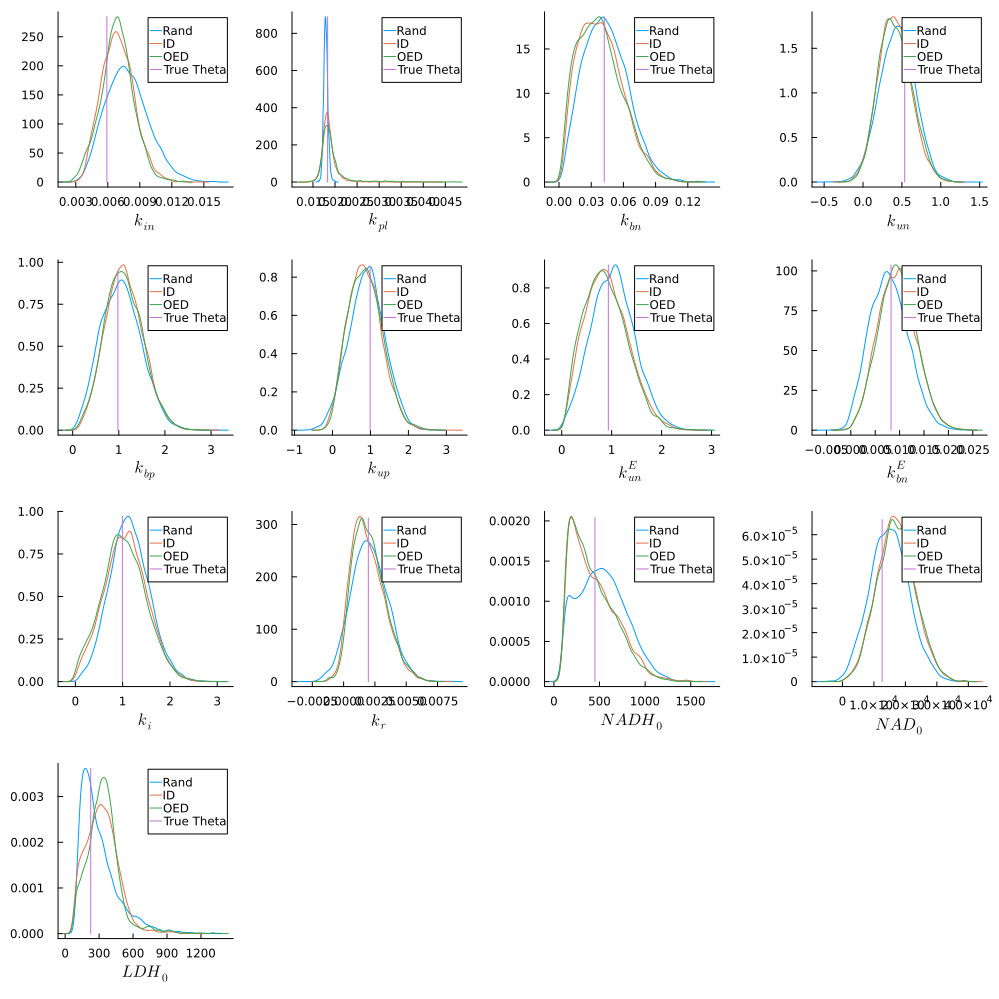

In [8]:
pls = Array{Any}(undef, length(namess));

i = 1
for i in 1:13
    pp1 = plot(kde(posterR1Cut[:,i]), label = "Rand", grid = false, xlabel = namess[i])
    plot!(kde(posterI1Cut[:,i]), label = "ID")
    plot!(kde(posterO1Cut[:,i]), label = "OED")
    plot!([trueTH[i], trueTH[i]], [0, maximum(hcat(kde(posterR1Cut[:,i]).density, kde(posterO1Cut[:,i]).density))], label = "True Theta")

    pls[i] = pp1
end

plot(pls[1],pls[2],pls[3],pls[4], pls[5],pls[6],pls[7],pls[8],pls[9],pls[10],pls[11],pls[12],pls[13], size = (1000,1000))

In [98]:
# pc = corrplot(posterR1Cut[:,10:13], label = namess)
# fp1 = plot(pc, size=(800,600), xtickfont=font(4), ytickfont=font(4), guidefont=font(10))

In [94]:
# pc = corrplot(posterO1Cut, label = namess)
# fp1 = plot(pc, size=(800,600), xtickfont=font(4), ytickfont=font(4), guidefont=font(10))

#### Iter 2

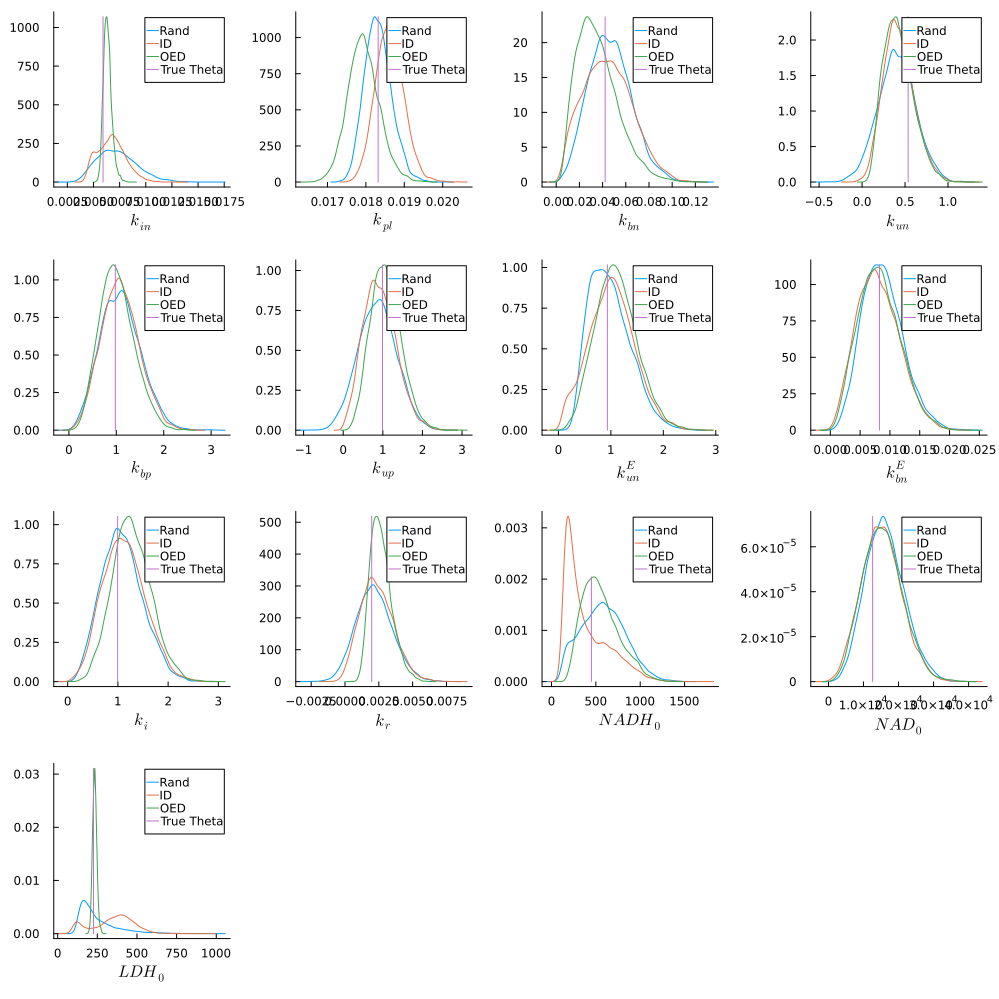

In [9]:
pls = Array{Any}(undef, length(namess));

i = 1
for i in 1:13
    pp1 = plot(kde(posterR2Cut[:,i]), label = "Rand", grid = false, xlabel = namess[i])
    plot!(kde(posterI2Cut[:,i]), label = "ID")
    plot!(kde(posterO2Cut[:,i]), label = "OED")
    plot!([trueTH[i], trueTH[i]], [0, maximum(hcat(kde(posterR2Cut[:,i]).density, kde(posterO2Cut[:,i]).density))], label = "True Theta")

    pls[i] = pp1
end

plot(pls[1],pls[2],pls[3],pls[4], pls[5],pls[6],pls[7],pls[8],pls[9],pls[10],pls[11],pls[12],pls[13], size = (1000,1000))

#### Iter 3

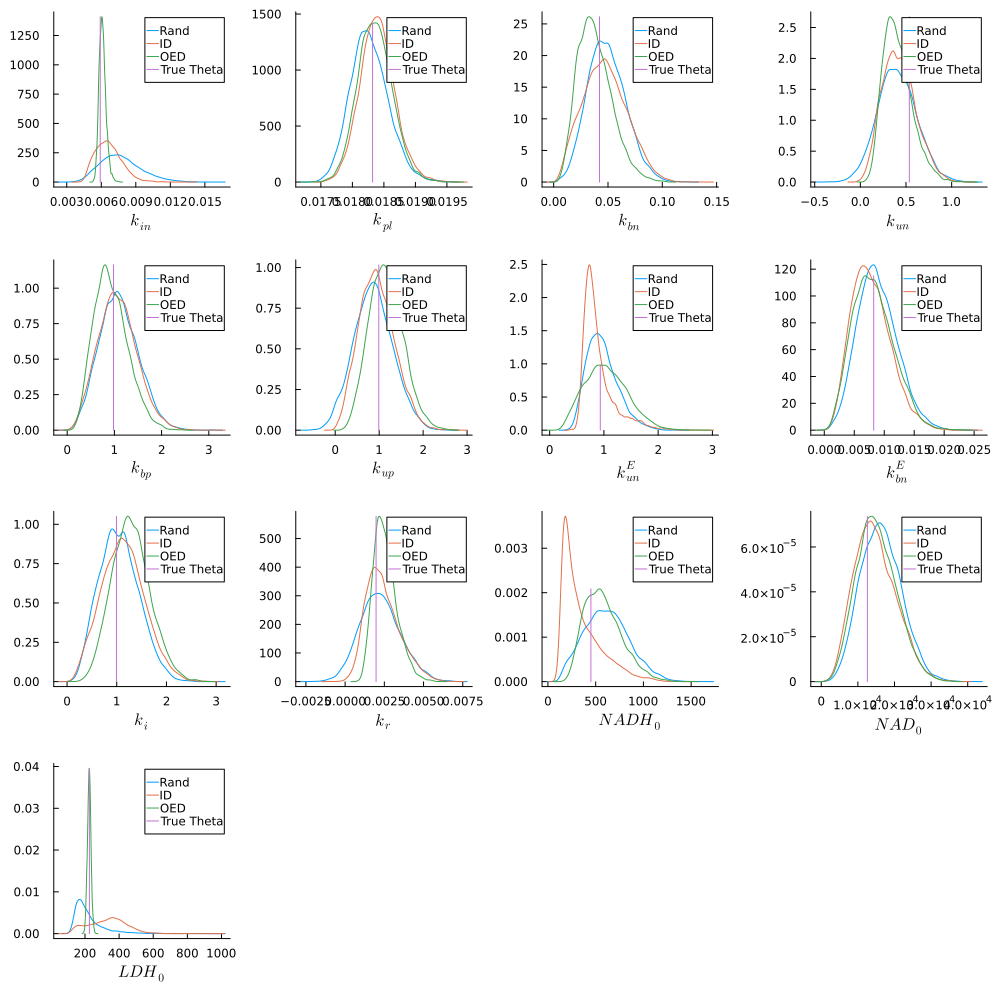

In [10]:
pls = Array{Any}(undef, length(namess));

i = 1
for i in 1:13
    pp1 = plot(kde(posterR3Cut[:,i]), label = "Rand", grid = false, xlabel = namess[i])
    plot!(kde(posterI3Cut[:,i]), label = "ID")
    plot!(kde(posterO3Cut[:,i]), label = "OED")
    # plot!([trueTH[i], trueTH[i]], [0, maximum(hcat(kde(posterR3Cut[:,i]).density, kde(posterO3Cut[:,i]).density))], label = "True Theta")
    plot!([trueTH[i], trueTH[i]], [0, maximum(hcat(kde(posterO3Cut[:,i]).density))], label = "True Theta")

    pls[i] = pp1
end

plot(pls[1],pls[2],pls[3],pls[4], pls[5],pls[6],pls[7],pls[8],pls[9],pls[10],pls[11],pls[12],pls[13], size = (1000,1000))

# Sample Distance to True Theta

The lower the metric, the better

In [11]:
dPSDR1, dPSDMR1 = dPSD_M(posterR1Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));
dPSDI1, dPSDMI1 = dPSD_M(posterI1Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));
dPSDO1, dPSDMO1 = dPSD_M(posterO1Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));

dPSDR2, dPSDMR2 = dPSD_M(posterR2Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));
dPSDI2, dPSDMI2 = dPSD_M(posterI2Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));
dPSDO2, dPSDMO2 = dPSD_M(posterO2Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));

dPSDR3, dPSDMR3 = dPSD_M(posterR3Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));
dPSDI3, dPSDMI3 = dPSD_M(posterI3Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));
dPSDO3, dPSDMO3 = dPSD_M(posterO3Cut, trueTH, vcat(bounds[2][3:12], boundY0[2]), vcat(bounds[1][3:12], boundY0[1]));


#### Iter 1

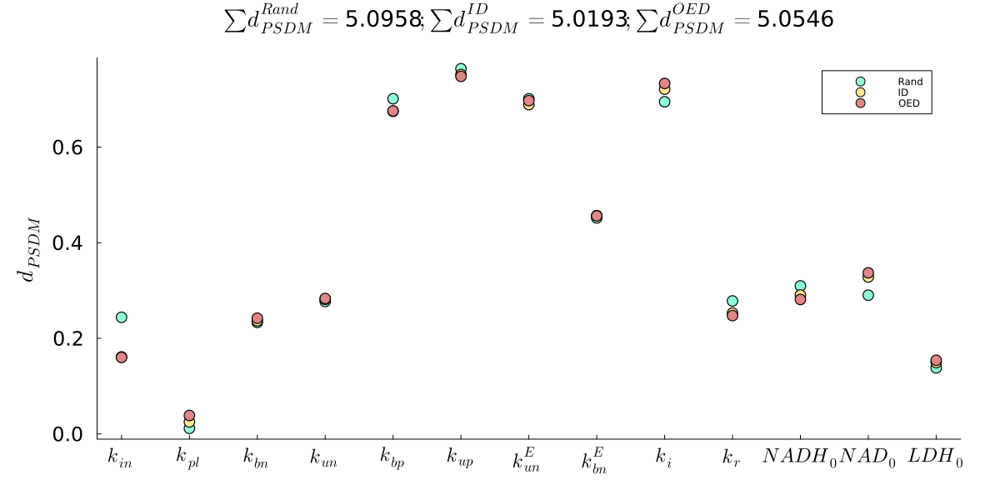

In [12]:
scatter(transpose(dPSDMR1), label = "Rand", grid=false, xticks = (1:13, namess), ylabel = L"d_{PSDM}", 
        margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
        size = (1200,600), markersize=7, colour = "#90ffd9ff")
scatter!(transpose(dPSDMI1), label = "ID", markersize=7, colour = "#ffe590ff")#, yaxis=:log)

scatter!(transpose(dPSDMO1), label = "OED", markersize=7, colour = "#de8787ff", 
        title = L"\sum d_{PSDM}^{Rand} = "*string(round(sum(dPSDMR1), digits=4))*L" ; \sum d_{PSDM}^{ID} = "*string(round(sum(dPSDMI1), digits=4))*L" ; \sum d_{PSDM}^{OED} = "*string(round(sum(dPSDMO1), digits=4)))#, yaxis=:log)

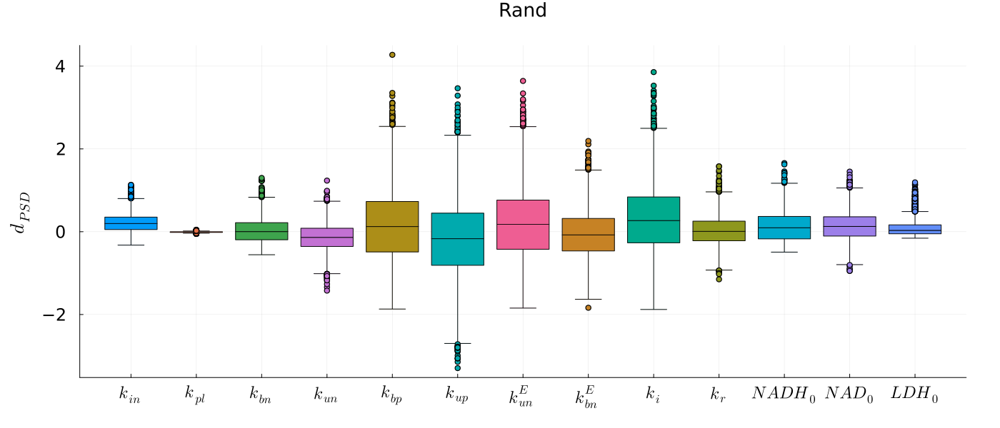

In [18]:
boxplot(dPSDR1, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "Rand", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

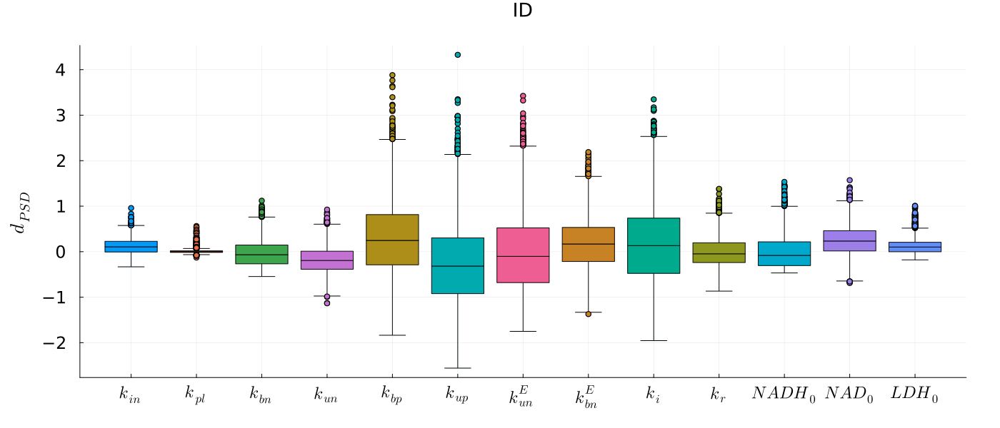

In [21]:
boxplot(dPSDI1, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "ID", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

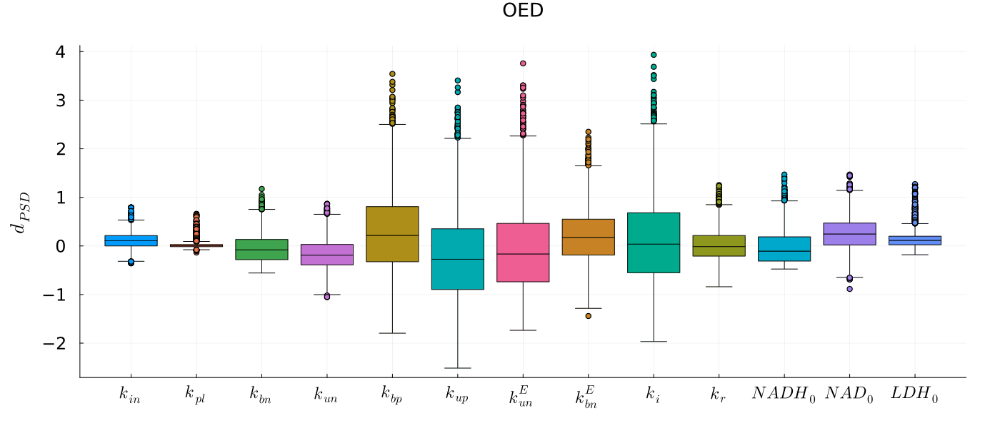

In [20]:
boxplot(dPSDO1, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "OED", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

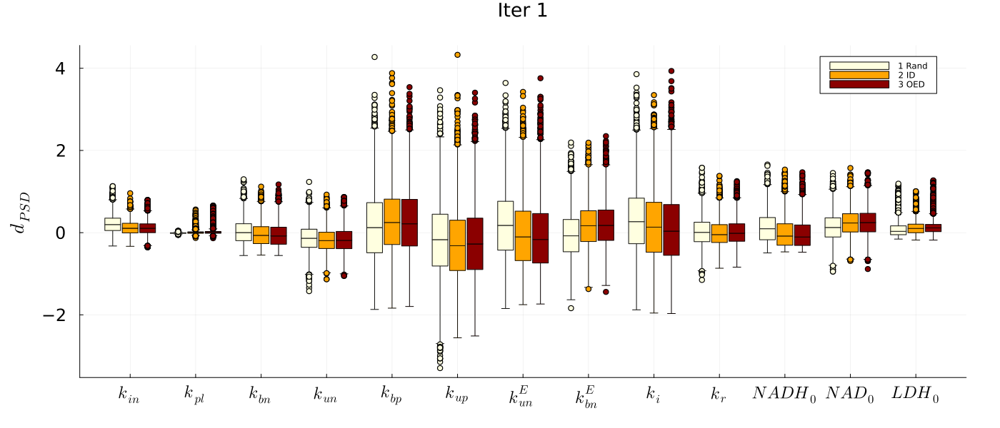

In [13]:
va = vcat(reshape(dPSDR1, 8000*13), reshape(dPSDI1, 8000*13), reshape(dPSDO1, 8000*13));
t = String[]
for j in 1:length(namess)
    for i in 1:8000
        push!(t,namess[j])
    end
end
xa = vcat(t,t,t);

ca = String[]
for i in 1:8000*13
    push!(ca,"1 Rand")
end
for i in 1:8000*13
    push!(ca,"2 ID")
end
for i in 1:8000*13
    push!(ca,"3 OED")
end

groupedboxplot(xa, va, group = ca, bar_width = 0.8, palette = :heat, ylabel = L"d_{PSD}", title = "Iter 1",  
margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
size = (1400,600))

#### Iter 2

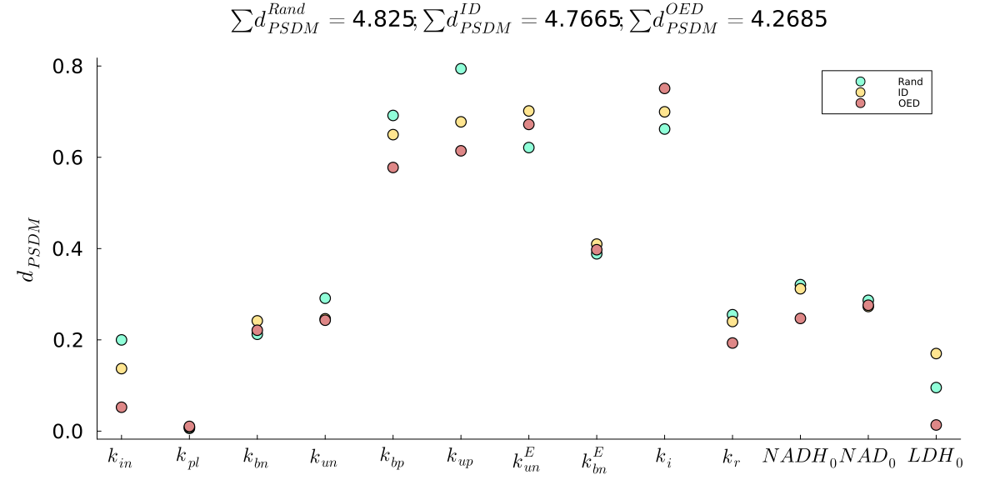

In [14]:
scatter(transpose(dPSDMR2), label = "Rand", grid=false, xticks = (1:13, namess), ylabel = L"d_{PSDM}", 
        margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
        size = (1200,600), markersize=7, colour = "#90ffd9ff")
scatter!(transpose(dPSDMI2), label = "ID", markersize=7, colour = "#ffe590ff")#, yaxis=:log)

scatter!(transpose(dPSDMO2), label = "OED", markersize=7, colour = "#de8787ff", 
        title = L"\sum d_{PSDM}^{Rand} = "*string(round(sum(dPSDMR2), digits=4))*L" ; \sum d_{PSDM}^{ID} = "*string(round(sum(dPSDMI2), digits=4))*L" ; \sum d_{PSDM}^{OED} = "*string(round(sum(dPSDMO2), digits=4)))#, yaxis=:log)

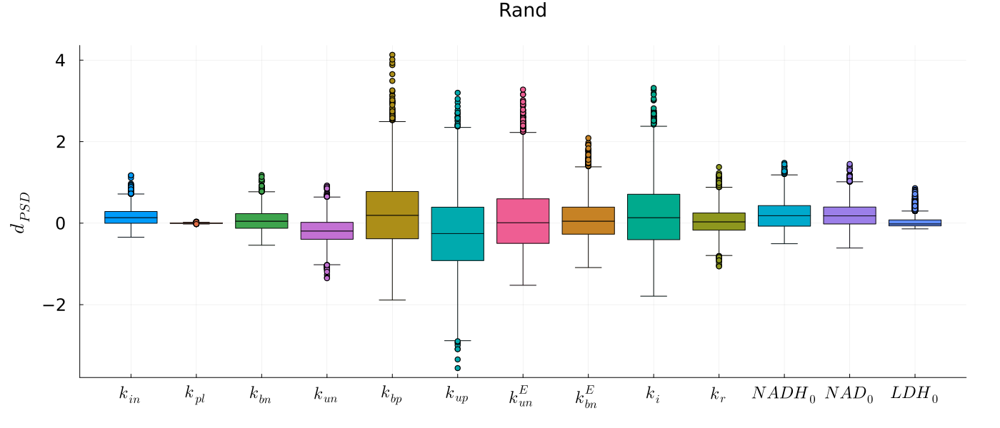

In [15]:
boxplot(dPSDR2, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "Rand", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

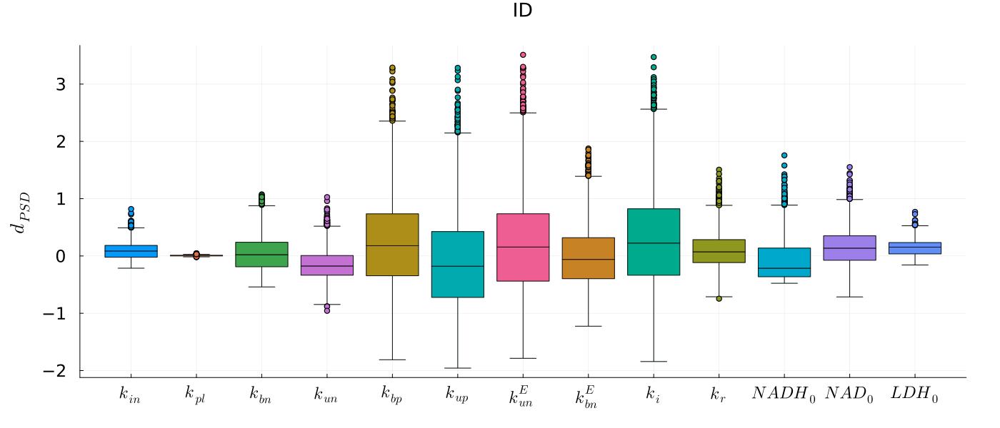

In [110]:
boxplot(dPSDI2, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "ID", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

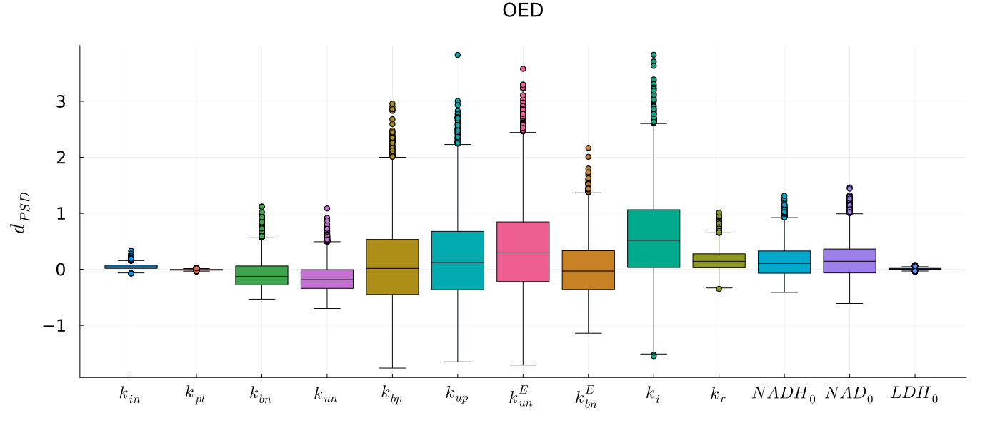

In [111]:
boxplot(dPSDO2, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "OED", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

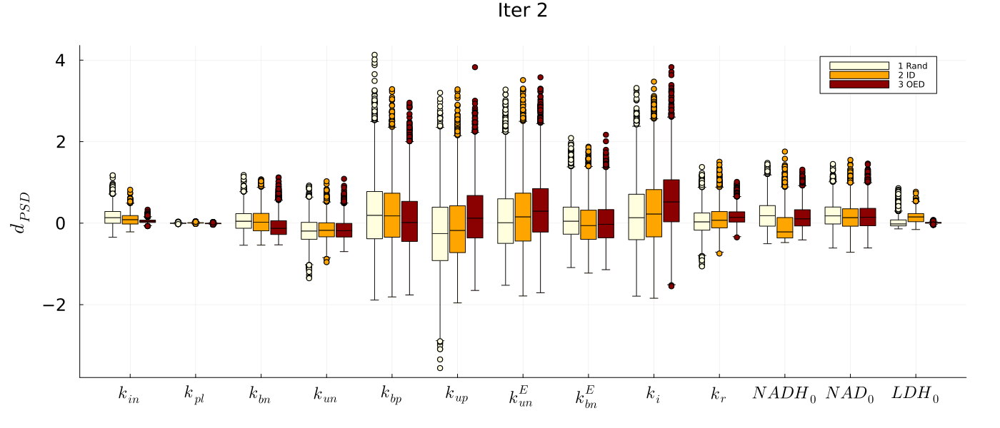

In [16]:
va = vcat(reshape(dPSDR2, 8000*13), reshape(dPSDI2, 8000*13), reshape(dPSDO2, 8000*13));
t = String[]
for j in 1:length(namess)
    for i in 1:8000
        push!(t,namess[j])
    end
end
xa = vcat(t,t,t);

ca = String[]
for i in 1:8000*13
    push!(ca,"1 Rand")
end
for i in 1:8000*13
    push!(ca,"2 ID")
end
for i in 1:8000*13
    push!(ca,"3 OED")
end

groupedboxplot(xa, va, group = ca, bar_width = 0.8, palette = :heat, ylabel = L"d_{PSD}", title = "Iter 2",  
margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
size = (1400,600))

#### Iter 3

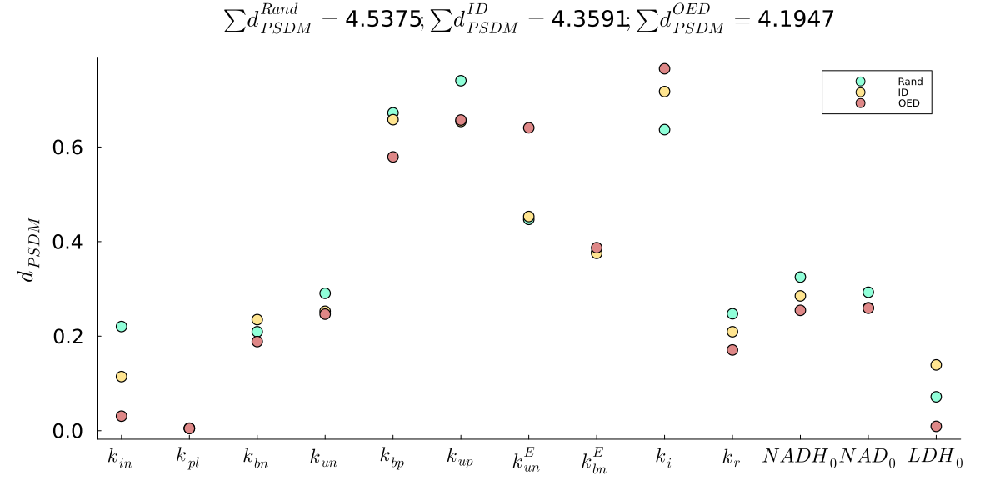

In [17]:
scatter(transpose(dPSDMR3), label = "Rand", grid=false, xticks = (1:13, namess), ylabel = L"d_{PSDM}", 
        margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
        size = (1200,600), markersize=7, colour = "#90ffd9ff")
scatter!(transpose(dPSDMI3), label = "ID", markersize=7, colour = "#ffe590ff")#, yaxis=:log)

scatter!(transpose(dPSDMO3), label = "OED", markersize=7, colour = "#de8787ff", 
        title = L"\sum d_{PSDM}^{Rand} = "*string(round(sum(dPSDMR3), digits=4))*L" ; \sum d_{PSDM}^{ID} = "*string(round(sum(dPSDMI3), digits=4))*L" ; \sum d_{PSDM}^{OED} = "*string(round(sum(dPSDMO3), digits=4)))#, yaxis=:log)

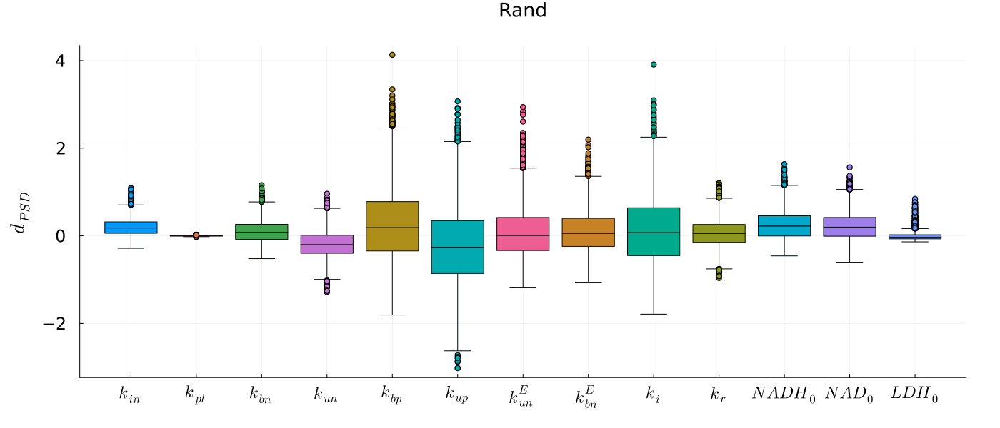

In [114]:
boxplot(dPSDR3, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "Rand", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

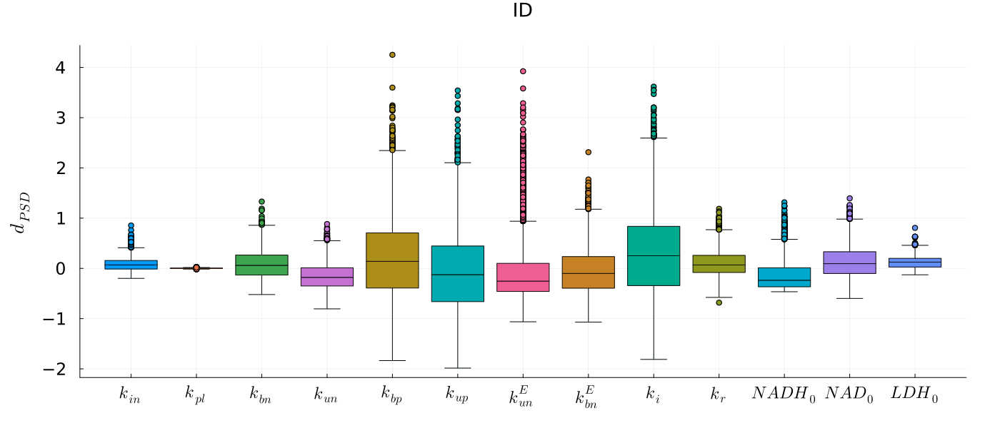

In [115]:
boxplot(dPSDI3, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "ID", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

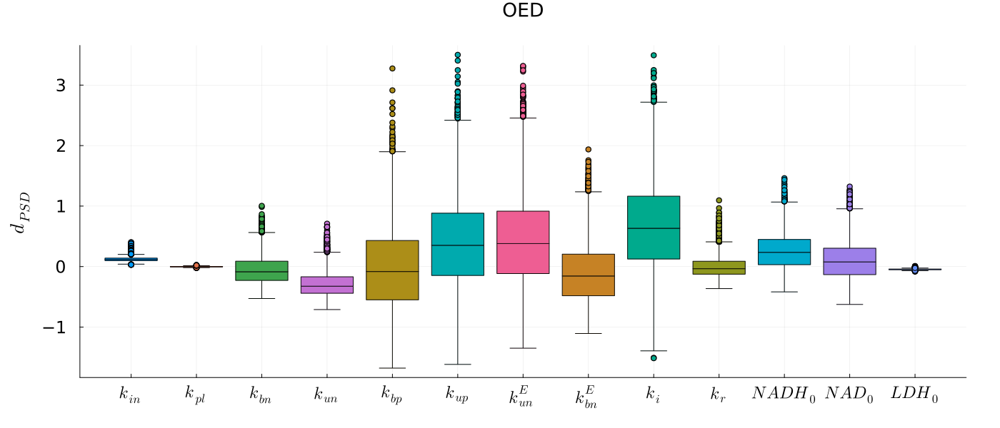

In [116]:
boxplot(dPSDO3, label = "", xticks = (1:13, namess), ylabel = L"d_{PSD}", title = "OED", 
    margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
    size = (1400,600))

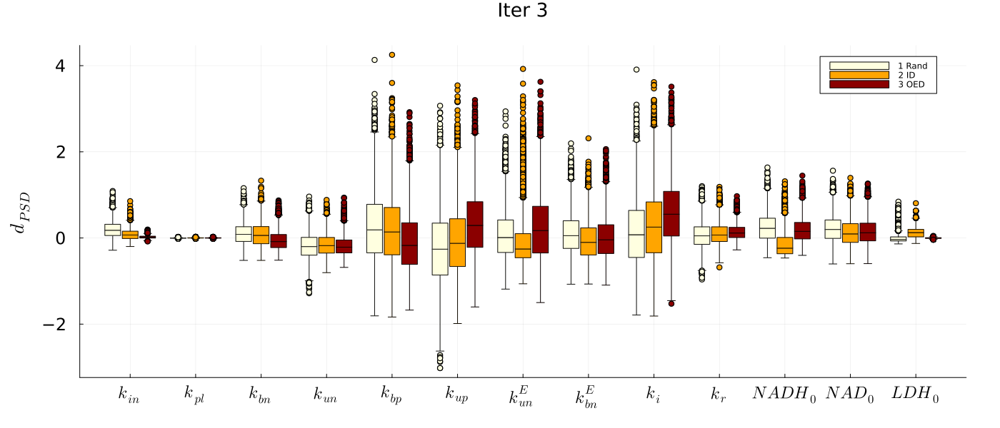

In [18]:
va = vcat(reshape(dPSDR3, 8000*13), reshape(dPSDI3, 8000*13), reshape(dPSDO3, 8000*13));
t = String[]
for j in 1:length(namess)
    for i in 1:8000
        push!(t,namess[j])
    end
end
xa = vcat(t,t,t);

ca = String[]
for i in 1:8000*13
    push!(ca,"1 Rand")
end
for i in 1:8000*13
    push!(ca,"2 ID")
end
for i in 1:8000*13
    push!(ca,"3 OED")
end

groupedboxplot(xa, va, group = ca, bar_width = 0.8, palette = :heat, ylabel = L"d_{PSD}", title = "Iter 3",  
margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
size = (1400,600))

#### Overall Analysis

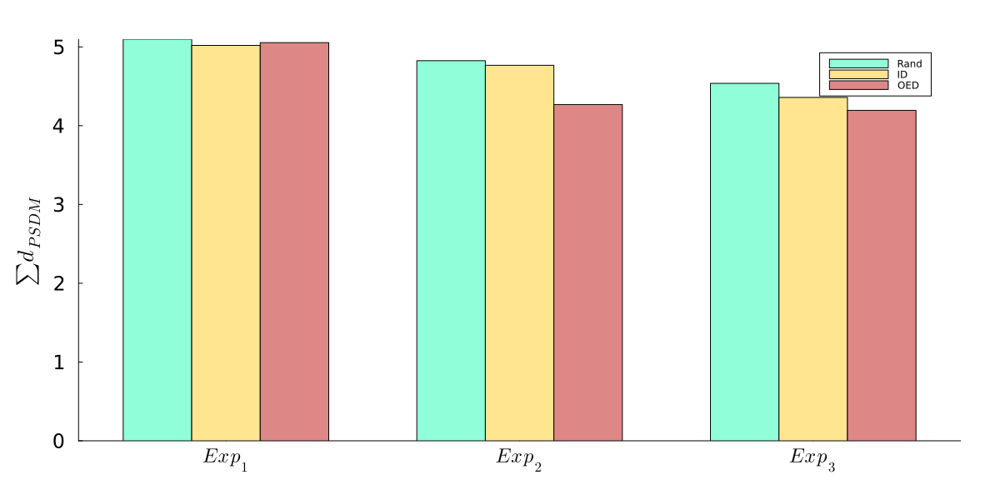

In [20]:

sdpsdmR = [sum(dPSDMR1), sum(dPSDMR2), sum(dPSDMR3)];
sdpsdmI = [sum(dPSDMI1), sum(dPSDMI2), sum(dPSDMI3)];
sdpsdmO = [sum(dPSDMO1), sum(dPSDMO2), sum(dPSDMO3)];

groupedbar([sdpsdmR sdpsdmI sdpsdmO] , bar_position = :dodge, bar_width=0.7, label = ["Rand" "ID" "OED"], colour = ["#90ffd9ff" "#ffe590ff" "#de8787ff"], xticks = (1:3, [L"Exp_1", L"Exp_2", L"Exp_3"]), 
        ylabel = L"\sum d_{PSDM}", margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
        size = (1200,600), grid = false)

# Posterior Covariance Determinant

The lower the metric, the better

In [21]:
# Prior
sts = [0.00275, 0.01375, 0.0225, 0.225, 0.475, 0.475, 0.475, 0.00425, 0.475, 0.00145, 260, 6400, 275];
log(det(Diagonal(ones(13)).*sts))

-10.50204958907828

In [ ]:
# Posteriors
CovsR = [log(det(cov(posterR1Cut))), log(det(cov(posterR2Cut))), log(det(cov(posterR3Cut)))];
CovsI = [log(det(cov(posterI1Cut))), log(det(cov(posterI2Cut))), log(det(cov(posterI3Cut)))];
CovsO = [log(det(cov(posterO1Cut))), log(det(cov(posterO2Cut))), log(det(cov(posterO3Cut)))];

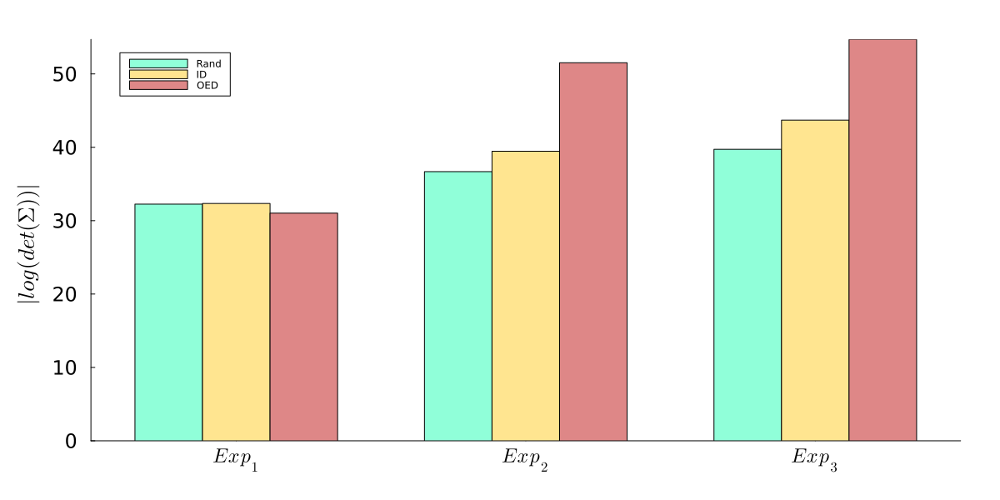

In [ ]:
groupedbar(abs.([CovsR CovsI CovsO]) , bar_position = :dodge, bar_width=0.7, label = ["Rand" "ID" "OED"], colour = ["#90ffd9ff" "#ffe590ff" "#de8787ff"], xticks = (1:3, [L"Exp_1", L"Exp_2", L"Exp_3"]), 
        ylabel = L"|log(det(\Sigma))|", margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
        size = (1200,600), grid = false)

# Entropy Difference

The higher the metric, the better

In [24]:
include("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\EntropyEstimationPosterior.jl")
using ScikitLearn.GridSearch
using ScikitLearnBase
using GaussianMixtures

In [25]:
mes = [0.0055, 0.0275, 0.045, 0.45, 0.95, 0.95, 0.95, 0.0085, 0.95, 0.0029, 650, 16000, 550];
sts = [0.00275, 0.01375, 0.0225, 0.225, 0.475, 0.475, 0.475, 0.00425, 0.475, 0.00145, 260, 6400, 275];

HPrior = entropy(MvNormal(mes, Diagonal(ones(13)).*sts));


Random

In [26]:
grid_searchM1FR = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:20)), verbose=0), posterR1Cut)

grid_searchM1FbR = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FR.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FR.best_estimator_.n*4:grid_searchM1FR.best_estimator_.n*4)), verbose=0), posterR1Cut)

┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 12 iterations (objv = 2.5912200918580788e10)


┌ Info: K-means with 2000 data points using 12 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 18 iterations (objv = 2.812809506952079e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 18 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 14 iterations (objv = 2.638947432600476e10)


┌ Info: K-means with 2000 data points using 14 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 19 iterations (objv = 2.064077573788981e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 19 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 24 iterations (objv = 2.1863846440993935e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 24 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 13 iterations (objv = 2.127228202799933e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 39 iterations (objv = 1.6510391933077427e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 39 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 23 iterations (objv = 1.7732782128881123e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 16 iterations (objv = 1.7106787305344486e10)


┌ Info: K-means with 4000 data points using 23 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 20 iterations (objv = 1.3927084684060669e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 20 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 29 iterations (objv = 1.4655755761321974e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 29 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.406108524981755e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.0754863620585869e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.1528434468046692e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 43 iterations (objv = 1.114317255762224e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 43 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 8.419047892023303e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 22 iterations (objv = 8.761040962428787e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 22 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 8.684397469119995e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 23 iterations (objv = 6.625938090361716e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 23 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.9429923220888405e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.707572986017744e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.784276822797726e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 26 iterations (objv = 5.75412735591983e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 26 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.668175480385212e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 25 iterations (objv = 4.5652888832151985e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 25 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 4.855083381254927e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 32 iterations (objv = 4.645170938199718e9)


┌ Info: K-means with 5333 data points using 34 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 32 iterations (objv = 3.967305394477191e9)


┌ Info: K-means with 5334 data points using 32 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 32 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 31 iterations (objv = 4.2085431676877756e9)


┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 31 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 19 iterations (objv = 4.0059244149279943e9)


┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 19 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.652386809032916e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 31.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.6195830479236345e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 31.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.7641380066039677e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.954949779830835e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 31.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 3.225282115589795e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 3.0823273682349796e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 28 iterations (objv = 2.6799072100905275e9)


┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 28 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.900161645835306e9)


┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.7905593374426026e9)


┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.3973525432314997e9)


┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 47 iterations (objv = 2.56582560085715e9)


┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 47 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.483091527164161e9)


┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 50 iterations (objv = 2.1724357366087604e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.33530321901562e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 30 iterations (objv = 2.2522280307552037e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.0055856756514754e9)


┌ Info: K-means with 5334 data points using 30 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.2185723508977613e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 48 iterations (objv = 2.0126292131652234e9)


┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 48 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 1.8434313921660104e9)


┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 35 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.021494864808544e9)


┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.934936869307665e9)


┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 32 iterations (objv = 1.7863606137504191e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 32 iterations
│ 20.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.8045124365758607e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 20.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 38 iterations (objv = 1.6814105293284762e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 38 iterations
│ 20.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 1.6038727252473593e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 35 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 13.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 

K-means terminated without convergence after 50 iterations (objv = 1.6882651426512086e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.6879134584234567e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 19.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 27 iterations (objv = 1.739069512263499e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.20067750354831e9)


┌ Info: K-means with 4000 data points using 27 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 2.340702444159608e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.3294580303650923e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.4076459540570254e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 35.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 -0.147913562037847
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [27]:
grid_searchM1FR2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:10)), verbose=0), posterR2Cut)

grid_searchM1FbR2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FR2.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FR2.best_estimator_.n*4:grid_searchM1FR2.best_estimator_.n*4)), verbose=0), posterR2Cut)

zim = sum(grid_searchM1FbR2.best_estimator_.w .== 0)
if zim != 0
        grid_searchM1FbR2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FR2.best_estimator_.n*3, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FR2.best_estimator_.n*3:grid_searchM1FR2.best_estimator_.n*3)), verbose=0), posterR2Cut)
end

K-means converged with 16 iterations (objv = 2.0472562434731148e10)
K-means converged with 17 iterations (objv = 2.2410840386053883e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 13 iterations (objv = 2.1924011129414658e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 13 iterations (objv = 1.6827056647489538e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 28 iterations (objv = 1.5597138300584877e10)


┌ Info: K-means with 3000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 26 iterations (objv = 1.58774566220117e10)


┌ Info: K-means with 3000 data points using 28 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 26 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 26 iterations (objv = 1.3928802515211674e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 26 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 36 iterations (objv = 1.3362438952776247e10)
K-means converged with 49 iterations (objv = 1.3559924469774288e10)


┌ Info: K-means with 4000 data points using 36 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 49 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 45 iterations (objv = 1.178518204133913e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 45 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 29 iterations (objv = 1.1163824436062328e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 29 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.1512453270350468e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 22 iterations (objv = 9.001052283840664e9)


┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 8.649944962089413e9)


┌ Info: K-means with 5333 data points using 22 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 30 iterations (objv = 8.77209302011736e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 30 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 7.1002852059637375e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.690250942689032e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.839874042340408e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 47 iterations (objv = 5.507766189180653e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 47 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 45 iterations (objv = 5.227494793177006e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 45 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.477068174833447e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 45 iterations (objv = 4.647819215361385e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 45 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.477122246418347e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.47812695317458e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 3.9380437514891443e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 49 iterations (objv = 3.626155767318001e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 39 iterations (objv = 3.7140819599573226e9)


┌ Info: K-means with 5333 data points using 49 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 43 iterations (objv = 1.4140478883268688e10)


┌ Info: K-means with 5334 data points using 39 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 43 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.0401383500217812e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ Ga

K-means terminated without convergence after 50 iterations (objv = 1.7711115893186126e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.8602598253773007e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.7079470688969865e9)


┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 35.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


In [28]:
grid_searchM1FR3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:20)), verbose=0), posterR3Cut)

grid_searchM1FbR3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FR3.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FR3.best_estimator_.n*4:grid_searchM1FR3.best_estimator_.n*4)), verbose=0), posterR3Cut)

K-means converged with 14 iterations (objv = 2.095293852977117e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 12 iterations (objv = 2.040786127502299e10)
K-means converged with 13 iterations (objv = 2.1270188020500484e10)


┌ Info: K-means with 2000 data points using 14 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 12 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 16 iterations (objv = 1.5389672920320831e10)
K-means converged with 23 iterations (objv = 1.6087202854253395e10)


┌ Info: K-means with 2000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 23 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 26 iterations (objv = 1.6464931793968454e10)
K-means converged with 7 iterations (objv = 1.282150501999585e10)

┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 26 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79



K-means converged with 28 iterations (objv = 1.3408960328374289e10)


┌ Info: K-means with 4000 data points using 7 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 28 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 13 iterations (objv = 1.3388334292378185e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 41 iterations (objv = 1.0766685692417953e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 41 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 36 iterations (objv = 1.1433217931320227e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 36 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 30 iterations (objv = 1.1570560603349636e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 17 iterations (objv = 8.432151464895006e9)


┌ Info: K-means with 5000 data points using 30 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 30 iterations (objv = 8.929926285685831e9)


┌ Info: K-means with 5333 data points using 17 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 30 iterations (objv = 9.111711249119778e9)


┌ Info: K-means with 5333 data points using 30 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 46 iterations (objv = 6.562704970574643e9)


┌ Info: K-means with 5334 data points using 30 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 6.919794793591898e9)


┌ Info: K-means with 5333 data points using 46 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.983257610984318e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.099193602685905e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 15 iterations (objv = 5.42827881967527e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 15 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 42 iterations (objv = 5.492294711588938e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 34 iterations (objv = 4.207191804992627e9)


┌ Info: K-means with 5334 data points using 42 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 4.39103467127472e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 18 iterations (objv = 4.4570271584274435e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 3.6756097935572886e9)


┌ Info: K-means with 5334 data points using 18 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.6020005235475035e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.7669348498699493e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 2.9485807547081566e9)


┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 35 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 36 iterations (objv = 3.0577321597907476e9)


┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 36 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 38 iterations (objv = 3.4217209810454836e9)


┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 38 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.649132294132617e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 31.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 47 iterations (objv = 2.607574688115181e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 47 iterations
│ 31.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.951970708840311e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.588293857185916e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 31.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.778852844454174e9)


┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 1.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 1.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 1.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 1.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 1.0 for Gausi

K-means converged with 48 iterations (objv = 2.437631511241802e9)


┌ Warning: Too low occupancy count 1.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.0861985068102279e9)


┌ Info: K-means with 5334 data points using 48 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 38 iterations (objv = 2.0651410241328108e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 38 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 48 iterations (objv = 2.1777292558702507e9)


┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 48 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 44 iterations (objv = 1.7621414542496037e9)
K-means converged with 36 iterations (objv = 1.839853500713871e9)


┌ Info: K-means with 5333 data points using 44 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.97658800283987e9)


┌ Info: K-means with 5333 data points using 36 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 44 iterations (objv = 1.65946366288639e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 25 iterations (objv = 1.7074664844118445e9)


┌ Info: K-means with 5333 data points using 44 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.7688694994373384e9)


┌ Info: K-means with 5333 data points using 25 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pat

K-means converged with 29 iterations (objv = 1.4875040575450807e9)


┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\

K-means terminated without convergence after 50 iterations (objv = 1.544461905642205e9)


┌ Info: K-means with 5333 data points using 29 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.5885950208319647e9)


┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 24 iterations (objv = 1.3673183896218514e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 24 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 46 iterations (objv = 1.3871060519494724e9)


┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.588382243995973e9)


┌ Info: K-means with 5333 data points using 46 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 17
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too 

K-means converged with 28 iterations (objv = 1.2585879133260808e9)


┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 17
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 17
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.j

K-means converged with 24 iterations (objv = 1.293123088097289e9)


┌ Info: K-means with 5333 data points using 28 iterations
│ 20.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 24 iterations
│ 20.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.3128964428958957e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 20.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 18
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 18
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 18
└ @ Ga

K-means terminated without convergence after 50 iterations (objv = 1.1868336488894506e9)


┌ Warning: Too low occupancy count 0.0 for Gausian 18
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 18
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.1899901297527037e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.3625088765631995e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 19.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 8.018724366693928e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 50 iterations (objv = 7.38414413258107e8)


┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 8
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 0.0 for Gausian 8
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 0.0 for Gausian 8
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 0.0 for Gausian 8
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 0.0 for Gausi

K-means converged with 33 iterations (objv = 6.760038220045524e8)


┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 33 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 26
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 26
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianM

K-means terminated without convergence after 50 iterations (objv = 7.131521413714154e8)


┌ Warning: Too low occupancy count 0.0 for Gausian 26
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 9
└ @ Gaus

K-means terminated without convergence after 50 iterations (objv = 1.0546143794613221e9)


┌ Info: K-means with 8000 data points using 50 iterations
│ 17.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 0.16047528623657428
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [35]:
gridsR = [grid_searchM1FbR, grid_searchM1FbR2, grid_searchM1FbR3];

Intuition Driven 

In [29]:
grid_searchM1FI = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:20)), verbose=0), posterI1Cut)

grid_searchM1FbI = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FI.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FI.best_estimator_.n*4:grid_searchM1FI.best_estimator_.n*4)), verbose=0), posterI1Cut)

K-means converged with 14 iterations (objv = 2.539486823191472e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 14 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 13 iterations (objv = 2.5509118883339214e10)
K-means converged with 11 iterations (objv = 2.5789155014714684e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 11 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 19 iterations (objv = 1.939612013678117e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 19 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 20 iterations (objv = 1.9505356108627014e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 20 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 16 iterations (objv = 1.9022334444137093e10)


┌ Info: K-means with 3000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.6154839645401936e10)


┌ Info: K-means with 4000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 1.6048079303975155e10)
K-means converged with 34 iterations (objv = 1.5782882736721025e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 34 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 17 iterations (objv = 1.37617191285229e10)


┌ Info: K-means with 4000 data points using 34 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 38 iterations (objv = 1.3916614998422926e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 38 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 37 iterations (objv = 1.3335194894197342e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 37 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 46 iterations (objv = 1.0676765953293129e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 46 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 36 iterations (objv = 1.0381090278159136e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 36 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 46 iterations (objv = 9.940832133338535e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 36 iterations (objv = 8.300177563275748e9)


┌ Info: K-means with 5334 data points using 46 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 36 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 29 iterations (objv = 8.145747060748842e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 29 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 50 iterations (objv = 7.734654464688543e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 41 iterations (objv = 6.62747196880045e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 41 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.588566601533881e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 29 iterations (objv = 6.14566032028313e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 5.285739778164995e9)


┌ Info: K-means with 5334 data points using 29 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.459945922064419e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.1705675908543825e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 4.35947308069369e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 43 iterations (objv = 4.41195311666918e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 4.2316220611536293e9)


┌ Info: K-means with 5333 data points using 43 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 40 iterations (objv = 3.733377086900211e9)


┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 3.6893141553337145e9)


┌ Info: K-means with 5333 data points using 40 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 30 iterations (objv = 3.627276804804594e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 11 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 30 iterations
│ 34.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.256932929482502e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 31.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.198009235603332e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 31.7 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.2490627463145485e9)


┌ Info: Initializing GMM, 12 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 31.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.8267177277650127e9)


┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.9438206949255733e9)


┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.826185510854785e9)


┌ Info: Initializing GMM, 13 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 29.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.538398293918178e9)


┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.709358891655162e9)


┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.5154627159374514e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 14 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 27.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.365622320809848e9)


┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 39 iterations (objv = 2.220934958582327e9)


┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 39 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.2708944482772436e9)


┌ Info: Initializing GMM, 15 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.1067324708907998e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 25.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.1468640881403291e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 2.091132160043062e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 16 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.0479845497002769e9)


┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ Ga

K-means terminated without convergence after 50 iterations (objv = 2.0379792440038586e9)


┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 19 iterations (objv = 1.8605226516402044e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 19 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 50 iterations (objv = 1.710363550009982e9)


┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 18 iterations (objv = 1.6865766943278942e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 18 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 39 iterations (objv = 1.7141832764752364e9)


┌ Info: Initializing GMM, 18 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 39 iterations
│ 21.2 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 31 iterations (objv = 1.6412726100030532e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 31 iterations
│ 20.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 1.5356993280960832e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 20.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 32 iterations (objv = 1.6123075471896176e9)


┌ Info: Initializing GMM, 19 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.5057509181344373e9)


┌ Info: K-means with 5334 data points using 32 iterations
│ 20.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 31 iterations (objv = 1.4398306367725098e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 31 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 1.473702175377887e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 35 iterations
│ 19.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 9.927255792706436e9)


┌ Info: K-means with 8000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 8.50374415564231e8)


┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ Ga

K-means converged with 31 iterations (objv = 8.442897370563433e8)


┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 31 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 11
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 11
└ @ Ga

K-means terminated without convergence after 50 iterations (objv = 8.999593819165905e8)


┌ Warning: Too low occupancy count 0.0 for Gausian 11
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ Ga

K-means converged with 43 iterations (objv = 1.295576325392104e9)


┌ Info: K-means with 8000 data points using 43 iterations
│ 17.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 15
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 15
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 15
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packag

GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 -0.13046303203420961
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [30]:
grid_searchM1FI2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:10)), verbose=0), posterI2Cut)

grid_searchM1FbI2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FI2.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FI2.best_estimator_.n*4:grid_searchM1FI2.best_estimator_.n*4)), verbose=0), posterI2Cut)

zim = sum(grid_searchM1FbI2.best_estimator_.w .== 0)
if zim != 0
        grid_searchM1FbI2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FI2.best_estimator_.n*3-zim, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FI2.best_estimator_.n*3-zim:grid_searchM1FI2.best_estimator_.n*3-zim)), verbose=0), posterI2Cut)
end

K-means converged with 17 iterations (objv = 2.360665935428435e10)
K-means converged with 12 iterations (objv = 2.248400453677644e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 9 iterations (objv = 2.200659609143376e10)


┌ Info: K-means with 2000 data points using 12 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 15 iterations (objv = 1.8023063969405205e10)
K-means converged with 30 iterations (objv = 1.842439499103984e10)


┌ Info: K-means with 2000 data points using 9 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 15 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 25 iterations (objv = 1.798249118149839e10)
K-means terminated without convergence after 50 iterations (objv = 1.4588432897032064e10)


┌ Info: K-means with 3000 data points using 30 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 25 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 30 iterations (objv = 1.4358785348628326e10)


┌ Info: K-means with 4000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.5033507674770258e10)


┌ Info: K-means with 4000 data points using 30 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 50 iterations (objv = 1.2273361995128176e10)
K-means terminated without convergence after 50 iterations (objv = 1.2228813615967564e10)

┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 50 iterations (objv = 1.2207429765452286e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 41 iterations (objv = 9.510401685004778e9)


┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 41 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 37 iterations (objv = 9.449281352267101e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 9.655505009047878e9)


┌ Info: K-means with 5333 data points using 37 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 7.308012798914114e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 32 iterations (objv = 7.1661388338335705e9)


┌ Info: K-means with 5333 data points using 32 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 7.2892596280655365e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.001295697934462e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 44 iterations (objv = 5.854854560844959e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 38 iterations (objv = 6.025334518288319e9)


┌ Info: K-means with 5333 data points using 44 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 38 iterations (objv = 4.963863244960082e9)


┌ Info: K-means with 5334 data points using 38 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 38 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.899475286461306e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 4.784497416325726e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 42 iterations (objv = 4.0360890492563286e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 42 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 47 iterations (objv = 4.369767365311659e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 3.948715904430994e9)


┌ Info: K-means with 5333 data points using 47 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.0948904693896114e10)


┌ Info: K-means with 5334 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 6000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 1.1249624094378946e9)


┌ Info: Initializing GMM, 24 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 15.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 31 iterations (objv = 1.0938414715533338e9)


┌ Info: Initializing GMM, 24 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 31 iterations
│ 15.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 16
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 16
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 16
└ @ Ga

K-means terminated without convergence after 50 iterations (objv = 1.1239101170510783e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 15.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.6440934676462617e9)

┌ Info: Initializing GMM, 24 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


┌ Info: K-means with 8000 data points using 50 iterations
│ 23.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packag

K-means terminated without convergence after 50 iterations (objv = 1.8564549585231748e9)


┌ Warning: Too low occupancy count 0.0 for Gausian 12
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.7202718674278953e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 13.0 for Gausian 7
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 7
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 13.0 for Gausian 7
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warni

K-means converged with 47 iterations (objv = 1.7745853394919014e9)


┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 47 iterations
│ 22.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 2.6892930351729965e9)


┌ Info: Initializing GMM, 17 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 33.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 0.19201872822077007
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [31]:
grid_searchM1FI3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:10)), verbose=0), posterI3Cut)

grid_searchM1FbI3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FI3.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FI3.best_estimator_.n*4:grid_searchM1FI3.best_estimator_.n*4)), verbose=0), posterI3Cut)

zim = sum(grid_searchM1FbI3.best_estimator_.w .== 0)
if zim != 0
        grid_searchM1FbI3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FI3.best_estimator_.n*3-zim, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FI3.best_estimator_.n*3-zim:grid_searchM1FI3.best_estimator_.n*3-zim)), verbose=0), posterI3Cut)
end

┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 17 iterations (objv = 1.9829440288098053e10)
K-means converged with 14 iterations (objv = 2.133529235027707e10)
K-means converged with 17 iterations (objv = 2.06214876120539e10)


┌ Info: K-means with 2000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 14 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 24 iterations (objv = 1.4815397491671131e10)
K-means converged with 21 iterations (objv = 1.6909861272407362e10)


┌ Info: K-means with 2000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 24 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 21 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 27 iterations (objv = 1.6163631655409847e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 27 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 26 iterations (objv = 1.268433709717118e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 26 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 46 iterations (objv = 1.3541123607110397e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 46 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 26 iterations (objv = 1.2690990232269028e10)


┌ Info: K-means with 4000 data points using 26 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 31 iterations (objv = 1.0652963879885029e10)
K-means converged with 50 iterations (objv = 1.1499758599568865e10)


┌ Info: K-means with 5000 data points using 31 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 36 iterations (objv = 1.0609470275110994e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 36 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 43 iterations (objv = 8.420808066223775e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 43 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 21 iterations (objv = 9.197391816577747e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 21 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 40 iterations (objv = 8.608413941237474e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 40 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.285601462988723e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.8159928643986435e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.361875217974293e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.940511365864044e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 23 iterations (objv = 5.387362810657741e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 23 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 47 iterations (objv = 5.010338967224459e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 47 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 29 iterations (objv = 3.9871804955552607e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 29 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 23 iterations (objv = 4.335854465702765e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 23 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.1743984415761003e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 35 iterations (objv = 3.3745866571034207e9)


┌ Info: K-means with 5333 data points using 35 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.6620701482165823e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 37 iterations (objv = 3.4992723951577816e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 37 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 7.853020299900176e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 32 iterations (objv = 6.326429788576144e8)


┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 32 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 24
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 24
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 24
└ @ Ga

K-means converged with 40 iterations (objv = 6.545889773290203e8)


┌ Warning: Too low occupancy count 0.0 for Gausian 24
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 40 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ Ga

K-means converged with 47 iterations (objv = 6.145401947619523e8)


┌ Warning: Too low occupancy count 0.0 for Gausian 22
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 47 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 29
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 29
└ @ Ga

K-means terminated without convergence after 50 iterations (objv = 9.64526054409972e8)


┌ Info: K-means with 8000 data points using 50 iterations
│ 17.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 2
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 2
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 2
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\

K-means terminated without convergence after 50 iterations (objv = 9.643018083770604e8)


┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 2
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 23 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 9.567522799773053e8)


┌ Info: K-means with 5333 data points using 50 iterations
│ 16.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 23 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 30 iterations (objv = 9.318464834640996e8)


┌ Info: K-means with 5333 data points using 50 iterations
│ 16.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 23 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 30 iterations
│ 16.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 10
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 10
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 p

K-means terminated without convergence after 50 iterations (objv = 1.39640476505338e9)


┌ Warning: Too low occupancy count 0.0 for Gausian 10
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Info: Initializing GMM, 23 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 24.8 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 0.3828612207324318
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [36]:
gridsI = [grid_searchM1FbI, grid_searchM1FbI2, grid_searchM1FbI3];

In [32]:
grid_searchM1FO = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:10)), verbose=0), posterO1Cut)

grid_searchM1FbO = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FO.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FO.best_estimator_.n*4:grid_searchM1FO.best_estimator_.n*4)), verbose=0), posterO1Cut)

┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 16 iterations (objv = 2.751133029677736e10)
K-means converged with 16 iterations (objv = 2.6552959114067535e10)


┌ Info: K-means with 2000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 11 iterations (objv = 2.4059409719052902e10)
K-means converged with 20 iterations (objv = 2.0753304738178047e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 11 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 20 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 8 iterations (objv = 1.886804405530429e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 8 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 17 iterations (objv = 1.887657185488578e10)
K-means converged with 25 iterations (objv = 1.6781308872870302e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 25 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 1.58694266884632e10)
K-means converged with 30 iterations (objv = 1.5357592900312588e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 35 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 1.4479481165140415e10)


┌ Info: K-means with 4000 data points using 30 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 23 iterations (objv = 1.4021118945040218e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 23 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 24 iterations (objv = 1.382887904078199e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 24 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.1267721356981876e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.0602358432597479e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.050420290124683e10)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 8.90708058138837e9)

┌ Info: K-means with 5334 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79



K-means converged with 31 iterations (objv = 8.140353202923419e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 8.335763698229866e9)


┌ Info: K-means with 5333 data points using 31 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 37 iterations (objv = 6.986281771227488e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 37 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.536335408271575e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.632974760969802e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.670354810939539e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 39 iterations (objv = 5.324108701406791e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 39 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.445499121211818e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.805506225668737e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 4.449615105052637e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 35 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 4.481168014751631e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.011442649796767e10)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 8.483481104171293e8)


┌ Info: Initializing GMM, 32 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 31
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 31
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 31
└ @ Ga

K-means converged with 45 iterations (objv = 8.57024972853656e8)


┌ Info: K-means with 5333 data points using 45 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 1.0 for Gausian 4
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 0.0 for Gausian 24
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 1.0 for Gausian 4
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 0.0 for Gausian 24
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\

K-means terminated without convergence after 50 iterations (objv = 8.623890040189312e8)


┌ Info: K-means with 5334 data points using 50 iterations
│ 11.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 20
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 1.0 for Gausian 21
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 20
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: Too low occupancy count 1.0 for Gausian 21
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.juli

K-means converged with 50 iterations (objv = 1.3122920371125617e9)


┌ Info: K-means with 8000 data points using 50 iterations
│ 17.9 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Warning: Too low occupancy count 0.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:69
┌ Warning: Too low occupancy count 0.0 for Gausian 19
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:266
┌ Warning: 13 pathological elements normalized
└ @ GaussianMixtures C:\Users\dgomez\.julia\packag

GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 -0.12757499597762575
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [33]:
grid_searchM1FO2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:10)), verbose=0), posterO2Cut)

grid_searchM1FbO2 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FO2.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FO2.best_estimator_.n*4:grid_searchM1FO2.best_estimator_.n*4)), verbose=0), posterO2Cut)

K-means converged with 8 iterations (objv = 2.199687051903385e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 8 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 10 iterations (objv = 2.304086015988936e10)
K-means converged with 11 iterations (objv = 2.087491184914859e10)


┌ Info: K-means with 2000 data points using 10 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 11 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 12 iterations (objv = 1.6977867910984364e10)
K-means converged with 17 iterations (objv = 1.7765029361900627e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 12 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 19 iterations (objv = 1.6788334116187128e10)
K-means converged with 20 iterations (objv = 1.4296854088830933e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 19 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 20 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 45 iterations (objv = 1.4500054735373495e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 45 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 29 iterations (objv = 1.4158780002934769e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 29 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 36 iterations (objv = 1.1835928248013153e10)


┌ Info: K-means with 5000 data points using 36 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 17 iterations (objv = 1.231201601082473e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.1978244904440475e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 45 iterations (objv = 9.20168997908907e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 45 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 9.86034820111912e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 9.33509694091917e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 42 iterations (objv = 7.093217815475016e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 42 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 7.237180531427151e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 46 iterations (objv = 7.048347406493195e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 46 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 35 iterations (objv = 5.588381734354647e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 35 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 36 iterations (objv = 5.615132386830414e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 36 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 5.537077955276097e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 32 iterations (objv = 4.490051912672997e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 32 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.622752984353151e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 4.475394829416864e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 18 iterations (objv = 3.882930308614938e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 18 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.896035721978792e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.7028444484369135e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.1683559436859106e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.2900555261983445e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 40 iterations (objv = 1.1756661423971546e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 40 iterations
│ 19.0 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 1.1610013185854468e9)


┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 30 iterations (objv = 1.732118754036405e9)


┌ Info: K-means with 5334 data points using 50 iterations
│ 19.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 20 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 30 iterations
│ 28.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 0.5979185792854176
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [34]:
grid_searchM1FO3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=10, kind=:full), 
        Dict(:n_components=>collect(1:10)), verbose=0), posterO3Cut)

grid_searchM1FbO3 = ScikitLearnBase.fit!(GridSearchCV(GMM(n_components=grid_searchM1FO3.best_estimator_.n*4, kind=:full), 
        Dict(:n_components=>collect(grid_searchM1FO3.best_estimator_.n*4:grid_searchM1FO3.best_estimator_.n*4)), verbose=0), posterO3Cut)

K-means converged with 13 iterations (objv = 2.0054234596074005e10)

┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79



K-means converged with 12 iterations (objv = 1.983799674863249e10)


┌ Info: K-means with 2000 data points using 13 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 12 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 19 iterations (objv = 2.0020063665153423e10)
K-means converged with 21 iterations (objv = 1.5880010717165113e10)


┌ Info: Initializing GMM, 2 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 2000 data points using 19 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 21 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 16 iterations (objv = 1.5398025304498951e10)
K-means converged with 16 iterations (objv = 1.597174937916687e10)


┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 3 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 3000 data points using 16 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 17 iterations (objv = 1.2495462107276417e10)


┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 25 iterations (objv = 1.1933956935503845e10)
K-means converged with 34 iterations (objv = 1.221140458420346e10)


┌ Info: K-means with 4000 data points using 17 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 25 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 4 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 4000 data points using 34 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 41 iterations (objv = 1.0775548885024994e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 41 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 28 iterations (objv = 1.058784919391805e10)


┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5000 data points using 28 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 5 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 12 iterations (objv = 1.0187600889410522e10)


┌ Info: K-means with 5000 data points using 12 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 8.46030444013438e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 33 iterations (objv = 8.219056307845726e9)


┌ Info: K-means with 5333 data points using 33 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 7.988636978523258e9)


┌ Info: Initializing GMM, 6 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 63.5 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.210179663477077e9)


┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 43 iterations (objv = 6.105004006440013e9)


┌ Info: K-means with 5333 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 6.010951598412369e9)


┌ Info: K-means with 5333 data points using 43 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 54.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 31 iterations (objv = 4.895239317956694e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 31 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 34 iterations (objv = 4.803149598094461e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 34 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 21 iterations (objv = 4.759144693796713e9)


┌ Info: Initializing GMM, 8 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means converged with 15 iterations (objv = 3.9014902130240607e9)


┌ Info: K-means with 5334 data points using 21 iterations
│ 47.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 4.1762369318320346e9)


┌ Info: K-means with 5333 data points using 15 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.795302752723496e9)


┌ Info: Initializing GMM, 9 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 50 iterations
│ 42.3 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 39 iterations (objv = 3.3092603370421057e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 39 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 3.3168754897333255e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 32 iterations (objv = 3.2406164705659137e9)


┌ Info: Initializing GMM, 10 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79


K-means terminated without convergence after 50 iterations (objv = 8.14773951131708e9)


┌ Info: K-means with 5334 data points using 32 iterations
│ 38.1 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141
┌ Info: Initializing GMM, 7 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 7000 data points using 50 iterations
│ 71.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.279612818998356e8)


┌ Info: Initializing GMM, 28 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 13.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 6.403317921983423e8)


┌ Info: Initializing GMM, 28 Gaussians diag covariance 13 dimensions using 5333 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5333 data points using 50 iterations
│ 13.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means converged with 33 iterations (objv = 5.959428778649629e8)


┌ Info: Initializing GMM, 28 Gaussians diag covariance 13 dimensions using 5334 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 5334 data points using 33 iterations
│ 13.6 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


K-means terminated without convergence after 50 iterations (objv = 9.592292818237253e8)


┌ Info: Initializing GMM, 28 Gaussians diag covariance 13 dimensions using 8000 data points
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:79
┌ Info: K-means with 8000 data points using 50 iterations
│ 20.4 data points per parameter
└ @ GaussianMixtures C:\Users\dgomez\.julia\packages\GaussianMixtures\yHlNS\src\train.jl:141


GridSearchCV
  estimator: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}
  param_grid: Dict{Symbol, Vector{Int64}}
  scoring: Nothing nothing
  loss_func: Nothing nothing
  score_func: Nothing nothing
  fit_params: Dict{Any, Any}
  n_jobs: Int64 1
  iid: Bool true
  refit: Bool true
  cv: Nothing nothing
  verbose: Int64 0
  error_score: String "raise"
  scorer_: score (function of type typeof(ScikitLearnBase.score))
  best_params_: Dict{Symbol, Any}
  best_score_: Float64 0.7362671111850068
  grid_scores_: Array{ScikitLearn.Skcore.CVScoreTuple}((1,))
  best_estimator_: GMM{Float64, Vector{UpperTriangular{Float64, Matrix{Float64}}}}


In [37]:
gridsO = [grid_searchM1FbO, grid_searchM1FbO2, grid_searchM1FbO3];

In [38]:
# First dimension number of experiments, second dimension type of experiments.
comps = Array{Any,2}(undef,3, 3);
weis = Array{Any,2}(undef, 3, 3);
meaas = Array{Any,2}(undef,3, 3);
covas = Array{Any,2}(undef,3, 3);

for i in 1:3 #number of experiments
    # Get and store best results
    comps[i,1] = length(gridsR[i].best_estimator_.w); # Number of components
    weis[i,1] = gridsR[i].best_estimator_.w; # Weights for each component
    meaas[i,1] = gridsR[i].best_estimator_.μ; # Means for each component
    covas[i,1] = [inv(Matrix(gridsR[i].best_estimator_.Σ[j]))*inv(Matrix(gridsR[i].best_estimator_.Σ[j])') 
        for j in 1:length(gridsR[i].best_estimator_.Σ)]; # Covariance Matrix for each component

    comps[i,2] = length(gridsI[i].best_estimator_.w); # Number of components
    weis[i,2] = gridsI[i].best_estimator_.w; # Weights for each component
    meaas[i,2] = gridsI[i].best_estimator_.μ; # Means for each component
    covas[i,2] = [inv(Matrix(gridsI[i].best_estimator_.Σ[j]))*inv(Matrix(gridsI[i].best_estimator_.Σ[j])') 
        for j in 1:length(gridsI[i].best_estimator_.Σ)];

    comps[i,3] = length(gridsO[i].best_estimator_.w); # Number of components
    weis[i,3] = gridsO[i].best_estimator_.w; # Weights for each component
    meaas[i,3] = gridsO[i].best_estimator_.μ; # Means for each component
    covas[i,3] = [inv(Matrix(gridsO[i].best_estimator_.Σ[j]))*inv(Matrix(gridsO[i].best_estimator_.Σ[j])') 
        for j in 1:length(gridsO[i].best_estimator_.Σ)];
end


In [39]:
JLD2.save("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\GMMPosters.jld", "comps", comps, "weis", weis, "meaas", meaas, "covas", covas)

In [40]:
comps = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\GMMPosters.jld")["comps"];
weis = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\GMMPosters.jld")["weis"];
meaas = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\GMMPosters.jld")["meaas"];
covas = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\GMMPosters.jld")["covas"];

In [41]:
H_U_Post = Array{Any,2}(undef,3,3);
H_L_Post = Array{Any,2}(undef,3,3);
H_Post = Array{Any,2}(undef,3,3);

for j in 1:3# number of experiments
    [H_U_Post[j,i] = H_Upper(weis[j,i], covas[j,i]) for i in 1:3];
    [H_L_Post[j,i] = H_Lower(weis[j,i], covas[j,i], meaas[j,i]) for i in 1:3];
    [H_Post[j,i] = H_est(comps[j,i], weis[j,i], meaas[j,i], covas[j,i]) for i in 1:3];
end

              Iteration 1 of 16
              Iteration 2 of 16
              Iteration 3 of 16
              Iteration 4 of 16
              Iteration 5 of 16
              Iteration 6 of 16
              Iteration 7 of 16
              Iteration 8 of 16
              Iteration 9 of 16
              Iteration 10 of 16
              Iteration 11 of 16
              Iteration 12 of 16
              Iteration 13 of 16
              Iteration 14 of 16
              Iteration 15 of 16
              Iteration 16 of 16
              Iteration 1 of 32
              Iteration 2 of 32
              Iteration 3 of 32
              Iteration 4 of 32
              Iteration 5 of 32
              Iteration 6 of 32
              Iteration 7 of 32
              Iteration 8 of 32
              Iteration 9 of 32
              Iteration 10 of 32
              Iteration 11 of 32
              Iteration 12 of 32
              Iteration 13 of 32
              Iteration 14 of 32
              Iteration 15 o

In [42]:
JLD2.save("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\EntroPosters.jld", "H_U_Post", H_U_Post, "H_L_Post", H_L_Post, "H_Post", H_Post)

In [43]:
H_U_Post = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\EntroPosters.jld")["H_U_Post"];
H_L_Post = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\EntroPosters.jld")["H_L_Post"];
H_Post = JLD2.load("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ComputationalBayesianOED\\Results\\EntroPosters.jld")["H_Post"];

In [44]:
display(string("              |     H Lower Bound      |            H            |      H Upper Bound      |"))
display("--------------------------------------------------------------------------------------------")
display(string("|    Rand 1   |      ",round(H_L_Post[1,1], digits = 8),"      |       ",round(H_Post[1,1], digits = 9),"        |       ",round(H_U_Post[1,1], digits = 9),"       |"))
display("--------------------------------------------------------------------------------------------")
display(string("|    Rand 2   |      ",round(H_L_Post[2,1], digits = 8),"      |       ",round(H_Post[2,1], digits = 6),"        |       ",round(H_U_Post[2,1], digits = 8),"        |"))
display("--------------------------------------------------------------------------------------------")
display(string("|    Rand 3   |      ",round(H_L_Post[3,1], digits = 8),"      |       ",round(H_Post[3,1], digits = 6),"         |       ",round(H_U_Post[3,1], digits = 8),"       |"))
display("--------------------------------------------------------------------------------------------")


"              |     H Lower Bound      |            H            |      H Upper Bound      |"

"--------------------------------------------------------------------------------------------"

"|    Rand 1   |      -10.62638129      |       -8.5261323        |       1.878716998       |"

"--------------------------------------------------------------------------------------------"

"|    Rand 2   |      -13.20881965      |       -11.113925        |       -0.63312206        |"

"--------------------------------------------------------------------------------------------"

"|    Rand 3   |      -15.04311303      |       -13.000217         |       -2.58095276       |"

"--------------------------------------------------------------------------------------------"

In [45]:
display(string("              |     H Lower Bound      |            H            |      H Upper Bound      |"))
display("--------------------------------------------------------------------------------------------")
display(string("|     ID 1    |      ",round(H_L_Post[1,2], digits = 8),"      |       ",round(H_Post[1,2], digits = 9),"        |       ",round(H_U_Post[1,2], digits = 9),"       |"))
display("--------------------------------------------------------------------------------------------")
display(string("|     ID 2    |      ",round(H_L_Post[2,2], digits = 8),"      |       ",round(H_Post[2,2], digits = 6),"        |       ",round(H_U_Post[2,2], digits = 8),"        |"))
display("--------------------------------------------------------------------------------------------")
display(string("|     ID 3    |      ",round(H_L_Post[3,2], digits = 8),"      |       ",round(H_Post[3,2], digits = 6),"         |       ",round(H_U_Post[3,2], digits = 8),"       |"))
display("--------------------------------------------------------------------------------------------")


"              |     H Lower Bound      |            H            |      H Upper Bound      |"

"--------------------------------------------------------------------------------------------"

"|     ID 1    |      -11.57992637      |       -9.508989145        |       NaN       |"

"--------------------------------------------------------------------------------------------"

"|     ID 2    |      -14.67142215      |       -12.870153        |       -2.15185409        |"

"--------------------------------------------------------------------------------------------"

"|     ID 3    |      -17.6802643      |       -15.540614         |       -5.21942019       |"

"--------------------------------------------------------------------------------------------"

In [46]:
display(string("              |     H Lower Bound      |            H            |      H Upper Bound      |"))
display("--------------------------------------------------------------------------------------------")
display(string("|    OED 1    |      ",round(H_L_Post[1,3], digits = 8),"      |       ",round(H_Post[1,3], digits = 9),"        |       ",round(H_U_Post[1,3], digits = 9),"       |"))
display("--------------------------------------------------------------------------------------------")
display(string("|    OED 2    |      ",round(H_L_Post[2,3], digits = 8),"      |       ",round(H_Post[2,3], digits = 6),"        |       ",round(H_U_Post[2,3], digits = 8),"        |"))
display("--------------------------------------------------------------------------------------------")
display(string("|    OED 3    |      ",round(H_L_Post[3,3], digits = 8),"      |       ",round(H_Post[3,3], digits = 6),"         |       ",round(H_U_Post[3,3], digits = 8),"       |"))
display("--------------------------------------------------------------------------------------------")


"              |     H Lower Bound      |            H            |      H Upper Bound      |"

"--------------------------------------------------------------------------------------------"

"|    OED 1    |      -11.46885971      |       -9.505179071        |       NaN       |"

"--------------------------------------------------------------------------------------------"

"|    OED 2    |      -20.32301371      |       -18.366862        |       -7.83766161        |"

"--------------------------------------------------------------------------------------------"

"|    OED 3    |      -22.29702019      |       -20.490245         |       -9.83502562       |"

"--------------------------------------------------------------------------------------------"

In [47]:
H_gain = Array{Any,2}(undef,3,3);
[H_gain[j,i] = HPrior-H_Post[j,i] for i in 1:3 for j in 1:3];


In [48]:
H_gain

3×3 Matrix{Any}:
 21.7213  22.7042  22.7004
 24.3091  26.0653  31.562
 26.1954  28.7358  33.6854

In [49]:
display(string("              |    Entropy Gain Rand   |    Entropy Gain IDs    |    Entropy Gain OEDs   |"))
display("------------------------------------------------------------------------------------------")
display(string("|    Mod 1    |      ",round(H_gain[1,1], digits = 9),"      |      ",round(H_gain[1,2], digits = 9),"      |      ",round(H_gain[1,3], digits = 9),"      |"))
display("------------------------------------------------------------------------------------------")
display(string("|    Mod 2    |      ",round(H_gain[2,1], digits = 9),"      |      ",round(H_gain[2,2], digits = 9),"        |      ",round(H_gain[2,3], digits = 9),"        |"))
display("------------------------------------------------------------------------------------------")
display(string("|    Mod 2    |      ",round(H_gain[3,1], digits = 9),"      |      ",round(H_gain[3,2], digits = 9),"        |      ",round(H_gain[3,3], digits = 9),"        |"))
display("------------------------------------------------------------------------------------------")


"              |    Entropy Gain Rand   |    Entropy Gain IDs    |    Entropy Gain OEDs   |"

"------------------------------------------------------------------------------------------"

"|    Mod 1    |      21.721308437      |      22.704165282      |      22.700355208      |"

"------------------------------------------------------------------------------------------"

"|    Mod 2    |      24.309101636      |      26.065329443        |      31.562038072        |"

"------------------------------------------------------------------------------------------"

"|    Mod 2    |      26.195393611      |      28.735789751        |      33.685420705        |"

"------------------------------------------------------------------------------------------"

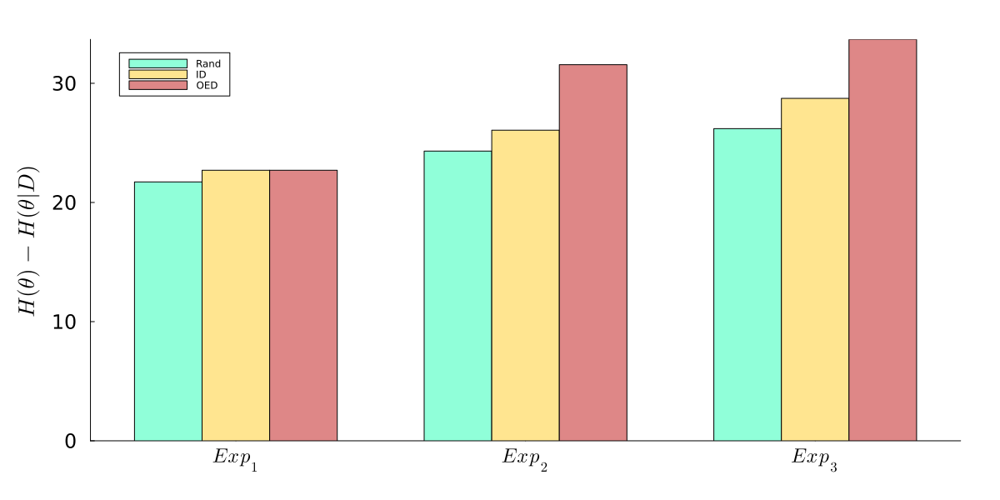

In [50]:
groupedbar(abs.([H_gain[:,1] H_gain[:,2] H_gain[:,3]]) , bar_position = :dodge, bar_width=0.7, label = ["Rand" "ID" "OED"], colour = ["#90ffd9ff" "#ffe590ff" "#de8787ff"], xticks = (1:3, [L"Exp_1", L"Exp_2", L"Exp_3"]), 
        ylabel = L"H(\theta)-H(\theta | D)", margin=10Plots.mm,xtickfont=font(16), ytickfont=font(16), guidefont=font(18), titlefont=font(18),
        size = (1200,600), grid = false)